# Computer Vision Project
#### Introduction to Machine learning course | Instructor: Dr. Fatemeh Mirsalehi

<font color='cyan'> Responsible TA: Amirhossein Razlighi </font>

In [1]:
%pip install torch torchvision numpy matplotlib Pillow

^C
Note: you may need to restart the kernel to use updated packages.


In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt

## Section 1: Implementing a CNN from scratch! (30 points)

### 1.1 - Forward and Backward (20/30 pts)

__CNN__ s are powerfull tools to work with in the scope of _Computer Vision_. You have seen MLPs before and know how to do forward and backward pass on them. In this part, we want to create a convolutional layer (a simple one, of course!) just to understand well that how a Convolutional Layer works, behind the scenes. Then, we can simply use PyTorch's `Conv2D` layer for the rest of this project, because we understood that how Convolutions work, behind the scene!

__FORWARD PASS__:

In forward pass, you should apply the convolution operation on the input image. The convolution operation is as follows:

$$
\text{output}[i, j] = \sum_{k=0}^{K-1} \sum_{l=0}^{L-1} \text{input}[i+k, j+l] \times \text{kernel}[k, l]
$$

You can see a sample convolution operation (with a $3 \times 3$ kernel) in the following image:
<div style="text-align:center;">
  <img src="./Images/Conv.gif" /> 
</div>

Please note that, these are samples for you to understand the operation better. For _forward pass_ that you should implement, please notice that you should convolve the kernel along all $C$ channels of the input image. So, the output shape should be $(N, H_{out}, W_{out})$. These values are calculated as follows:

$$
H_{out} = \frac{H_{in} + 2 \times \text{padding}}{\text{stride} - HH} + 1
$$
$$
W_{out} = \frac{W_{in} + 2 \times \text{padding}}{\text{stride} - WW} + 1
$$


where $HH$ and $WW$ are the height and width of the kernel, respectively. __stride__ is the step size of the kernel, and __padding__ is the number of zeros that should be padded to the input image. Please also note that $b$ stands for bias, which is a scalar value that should be added to the output of the convolution operation. (for each kernel)

You can see a more detailed example, below:

<div style="text-align:center;">
  <img src="./Images/conv3.gif" /> 
</div>

__Backward Pass__:

In backward pass, you should calculate gradient of output with respect to the input image and the kernel. These gradients will be used in _optimization_ to update kernel weights. (You saw something similar, in using MLPs with gradient descent algorithm!). So, we need $d_x$, $d_w$ and $d_b$ in the backward pass. These are calculated as follows:

$$
dx_{padded} [n, :, i * stride: i * stride + HH, j * stride: j * stride + WW] += w[f] \times dout[n, f, i, j]
$$

$$
dw_{f} = \sum_{n=0}^{N - 1} \sum_{i=0}^{H_{out} - 1} \sum_{j=0}^{W_{out} - 1} x_{padded}[n, :, i * stride: i * stride + HH, j * stride: j * stride + WW] \times dout[n, f, i, j]  
$$

$$
db_{f} = \sum_{n=0}^{N - 1} \sum_{i=0}^{H_{out} - 1} \sum_{j=0}^{W_{out} - 1} dout[n, f, i, j]
$$

For better understanding of the backward pass, you can see the following image:

<div style="text-align:center;">
  <img src="./Images/backprop_cs231n.png" />
</div>


In [2]:
import numpy as np

class MyConv:
    def __init__(self, stride, padding):
        self.stride = stride  # Set the stride for the convolution
        self.padding = padding  # Set the padding for the convolution

    def forward(self, x, w, b):
        out = None  # Initialize the output to None

        ####### TO DO : Implement Forward pass of Conv2D #######
        ########################################################

        N, C, H, W = x.shape  # Extract the dimensions of the input
        F, _, HH, WW = w.shape  # Extract the dimensions of the filters
        pad = self.padding  # Padding value
        stride = self.stride  # Stride value
        H_out = (H + 2 * pad - HH) // stride + 1  # Calculate the height of the output
        W_out = (W + 2 * pad - WW) // stride + 1  # Calculate the width of the output

        # Pad the input array
        x_pad = np.pad(x, ((0, 0), (0, 0), (pad, pad), (pad, pad)), mode='constant')
        out = np.zeros((N, F, H_out, W_out))  # Initialize the output array

        # Perform the convolution operation
        for n in range(N):  # Iterate over each example in the batch
            for f in range(F):  # Iterate over each filter
                for k in range(H_out):  # Iterate over the output height
                    for l in range(W_out):  # Iterate over the output width
                        h_start = k * stride  # Calculate the starting height index for the slice
                        h_end = h_start + HH  # Calculate the ending height index for the slice
                        w_start = l * stride  # Calculate the starting width index for the slice
                        w_end = w_start + WW  # Calculate the ending width index for the slice
                        x_slice = x_pad[n, :, h_start:h_end, w_start:w_end]  # Extract the slice of the input
                        out[n, f, k, l] = np.sum(x_slice * w[f]) + b[f]  # Perform the convolution operation

        ####### TO DO : End #######
        #############################

        cache = (x, w, b, x_pad)  # Store the values needed for the backward pass
        self.cache = cache  # Save the cache
        return out  # Return the output

    def backward(self, dout):
        dx, dw, db = None, None, None  # Initialize the gradients to None

        x, w, b, x_padded = self.cache  # Retrieve the cached values from the forward pass

        ####### TO DO : Implement backward pass #######
        ###############################################

        N, C, H, W = x.shape  # Extract the dimensions of the input
        F, _, HH, WW = w.shape  # Extract the dimensions of the filters
        _, _, H_OUT, W_OUT = dout.shape  # Extract the dimensions of the gradient of the output

        dw = np.zeros_like(w)  # Initialize the gradient of the filters to zeros
        db = np.zeros_like(b)  # Initialize the gradient of the biases to zeros
        dx_padded = np.zeros_like(x_padded)  # Initialize the gradient of the padded input to zeros
        
        # Compute the gradients
        for n in range(N):  # Iterate over each example in the batch
            for f in range(F):  # Iterate over each filter
                for i in range(H_OUT):  # Iterate over the output height
                    for j in range(W_OUT):  # Iterate over the output width
                        h_start = i * self.stride  # Calculate the starting height index for the slice
                        h_end = h_start + HH  # Calculate the ending height index for the slice
                        w_start = j * self.stride  # Calculate the starting width index for the slice
                        w_end = w_start + WW  # Calculate the ending width index for the slice

                        x_slice = x_padded[n, :, h_start:h_end, w_start:w_end]  # Extract the slice of the input
                        
                        dw[f] += x_slice * dout[n, f, i, j]  # Update the gradient of the filters
                        dx_padded[n, :, h_start:h_end, w_start:w_end] += w[f] * dout[n, f, i, j]  # Update the gradient of the padded input
                        db[f] += dout[n, f, i, j]  # Update the gradient of the biases

        if self.padding > 0:
            dx = dx_padded[:, :, self.padding:-self.padding, self.padding:-self.padding]  # Remove padding from the gradient of the input
        else:
            dx = dx_padded  # No padding to remove

        ####### TO DO : End #######
        #############################

        self.dx = dx  # Save the gradient of the input
        self.dw = dw  # Save the gradient of the filters
        self.db = db  # Save the gradient of the biases
        return dx, dw, db  # Return the gradients


In [4]:
def rel_error(x, y):
  return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

In [5]:
# A simple test for forward pass (DO NOT CHANGE)

x_shape = (2, 3, 4, 4)
w_shape = (3, 3, 4, 4)
x = np.linspace(-0.1, 0.5, num=np.prod(x_shape)).reshape(x_shape)
w = np.linspace(-0.2, 0.3, num=np.prod(w_shape)).reshape(w_shape)
b = np.linspace(-0.1, 0.2, num=3)

out = MyConv(stride=2, padding=1).forward(x, w, b)
correct_out = np.array([[[[[-0.08759809, -0.10987781],
                           [-0.18387192, -0.2109216 ]],
                          [[ 0.21027089,  0.21661097],
                           [ 0.22847626,  0.23004637]],
                          [[ 0.50813986,  0.54309974],
                           [ 0.64082444,  0.67101435]]],
                         [[[-0.98053589, -1.03143541],
                           [-1.19128892, -1.24695841]],
                          [[ 0.69108355,  0.66880383],
                           [ 0.59480972,  0.56776003]],
                          [[ 2.36270298,  2.36904306],
                           [ 2.38090835,  2.38247847]]]]])

# The outputted difference which is printed, should be around 1e-8
print ('Testing conv_forward_naive')
print ('difference: ', rel_error(out, correct_out))

Testing conv_forward_naive
difference:  2.2121476417505994e-08


In [6]:
def eval_numerical_gradient_array(f, x, df, h=1e-5):
  grad = np.zeros_like(x)
  it = np.nditer(x, flags=['multi_index'], op_flags=['readwrite'])
  while not it.finished:
    ix = it.multi_index
    
    oldval = x[ix]
    x[ix] = oldval + h
    pos = f(x).copy()
    x[ix] = oldval - h
    neg = f(x).copy()
    x[ix] = oldval
    
    grad[ix] = np.sum((pos - neg) * df) / (2 * h)
    it.iternext()
  return grad

In [7]:
# A simple test for backward pass (DO NOT CHANGE)

x = np.random.randn(4, 3, 5, 5)
w = np.random.randn(2, 3, 3, 3)
b = np.random.randn(
    2,
)
dout = np.random.randn(4, 2, 5, 5)
conv = MyConv(stride=1, padding=1)

dx_num = eval_numerical_gradient_array(
    lambda x: conv.forward(x, w, b), x, dout
)
dw_num = eval_numerical_gradient_array(
    lambda w: conv.forward(x, w, b), w, dout
)
db_num = eval_numerical_gradient_array(
    lambda b: conv.forward(x, w, b), b, dout
)

out = conv.forward(x, w, b)
dx, dw, db = conv.backward(dout)

# Your printed errors should be around 1e-9
print("Testing conv_backward_naive function")
print("dx error: ", rel_error(dx, dx_num))
print("dw error: ", rel_error(dw, dw_num))
print("db error: ", rel_error(db, db_num))

Testing conv_backward_naive function
dx error:  3.1714420263141846e-08
dw error:  1.7625859298148483e-10
db error:  1.6487401527337332e-12


### 1.2 - Visualizing Convolution results (10/30 pts)

In this part, we try to visualize the results of the convolution operation. We will 2 sample photos (in `Images/Sample`) and then we will use our `MyConv` class to apply some cool convolutions (and see their result on an image).

In [3]:
from PIL import Image

first_img, second_img = Image.open("./Images/Sample/Sharif_1.JPG"), Image.open(
    "./Images/Sample/Sharif_2.jpg"
)
first_img = first_img.resize((256, 256))
second_img = second_img.resize((256, 256))

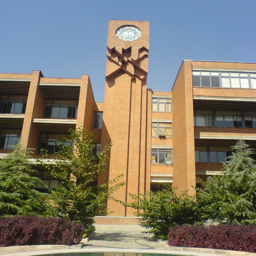

In [4]:
first_img

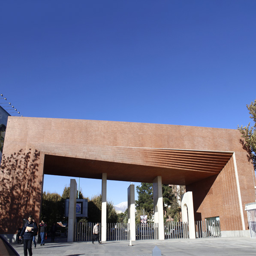

In [5]:
second_img

Convolutions have some interesting usages in image processing. For example, you can extract edges from an image by applying a convolution with a kernel that detects edges. Or you can convolve a specific kernel with your image to make it grayscale or blurred! Look at the definitions below:

__Edge Detection Kernel__:

_Sobel_ is one of the most famous edge detection kernels. It has two kernels, one for detecting vertical edges and the other for horizontal edges. You can see the kernels below:
$$
\text{Sobel}_x = \begin{bmatrix}
-1 & 0 & 1 \\
-2 & 0 & 2 \\
-1 & 0 & 1
\end{bmatrix}
$$

$$
\text{Sobel}_y = \begin{bmatrix}
-1 & -2 & -1 \\
0 & 0 & 0 \\
1 & 2 & 1
\end{bmatrix}
$$


__Grayscale Kernel__:

You can simply convolve the image with the following kernel to make it grayscale:

$$
\text{Grayscale\_across\_R} = \begin{bmatrix}
0 & 0 & 0 \\
0 & 0.3 & 0 \\
0 & 0 & 0
\end{bmatrix}
$$

$$
\text{Grayscale\_across\_G} = \begin{bmatrix}
0 & 0 & 0 \\
0 & 0.6 & 0 \\
0 & 0 & 0
\end{bmatrix}
$$

$$
\text{Grayscale\_across\_B} = \begin{bmatrix}
0 & 0 & 0 \\
0 & 0.1 & 0 \\
0 & 0 & 0
\end{bmatrix}
$$

(Convolve each kernel with its corresponding channel)

__Blurring Kernel__:

One of the famous kernels to blur an image is _Gaussian Blur_. You can see the kernel below:

$$
\text{Gaussian\_Blur} = \frac{1}{16} \times \begin{bmatrix}
1 & 2 & 1 \\
2 & 4 & 2 \\
1 & 2 & 1
\end{bmatrix}
$$


In [11]:
img_size = 256

# Initialize an empty array to hold two images with 3 color channels (RGB), each of size 256x256
x = np.zeros((2, 3, img_size, img_size))

# Convert the first image to a numpy array, transpose to (channels, height, width), and assign to the first entry in x
x[0] = np.array(first_img).transpose(2, 0, 1)

# Convert the second image to a numpy array, transpose to (channels, height, width), and assign to the second entry in x
x[1] = np.array(second_img).transpose(2, 0, 1)

# Define convolution weights, holding 4 filters each of size 3x3 with 3 input channels (one for each RGB channel)
w = np.array([
    # Sobel_y filter for edge detection (horizontal edges)
    [[[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]],  # Red channel
     [[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]],  # Green channel
     [[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]]], # Blue channel
    
    # Sobel_x filter for edge detection (vertical edges)
    [[[-1, -2, -1], [0, 0, 0], [1, 2, 1]],  # Red channel
     [[-1, -2, -1], [0, 0, 0], [1, 2, 1]],  # Green channel
     [[-1, -2, -1], [0, 0, 0], [1, 2, 1]]], # Blue channel
    
    # Grayscale filter for Red channel
    [[[0, 0, 0], [0, 0.3, 0], [0, 0, 0]],   # Red channel
     [[0, 0, 0], [0, 0.3, 0], [0, 0, 0]],   # Green channel
     [[0, 0, 0], [0, 0.3, 0], [0, 0, 0]]],  # Blue channel
    
    # Grayscale filter for Green channel
    [[[0, 0, 0], [0, 0.6, 0], [0, 0, 0]],   # Red channel
     [[0, 0, 0], [0, 0.6, 0], [0, 0, 0]],   # Green channel
     [[0, 0, 0], [0, 0.6, 0], [0, 0, 0]]]   # Blue channel
])

# Bias terms for the filters
b = np.array([0, 128, 128, 0])

# Create an instance of MyConv with stride 1 and padding 1
conv = MyConv(stride=1, padding=1)

# Perform the forward pass of the convolution operation
out = conv.forward(x, w, b)

# Print the shapes of the input and output to verify the correctness
print("Input shape:", x.shape)
print("Output shape:", out.shape)

Input shape: (2, 3, 256, 256)
Output shape: (2, 4, 256, 256)


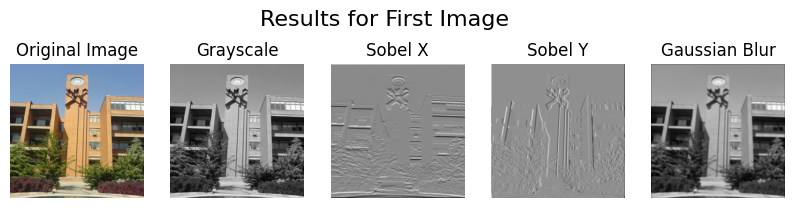

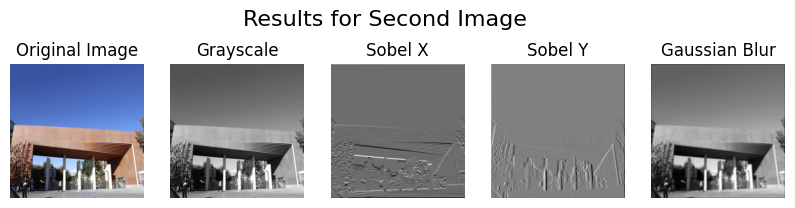

In [6]:
import matplotlib.pyplot as plt

#TODO: Plot the original image, grayscale, sobel x, sobel y, and gaussian blur of each image

# Define kernels for Sobel, Grayscale, and Gaussian Blur
sobel_y_kernel = np.array([[[[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]],
                             [[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]],
                             [[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]]]])

sobel_x_kernel = np.array([[[[-1, -2, -1], [0, 0, 0], [1, 2, 1]],
                             [[-1, -2, -1], [0, 0, 0], [1, 2, 1]],
                             [[-1, -2, -1], [0, 0, 0], [1, 2, 1]]]])

grayscale_kernel = np.array([[[[0, 0, 0], [0, 0.3, 0], [0, 0, 0]],
                              [[0, 0, 0], [0, 0.6, 0], [0, 0, 0]],
                              [[0, 0, 0], [0, 0.1, 0], [0, 0, 0]]]])

gaussian_blur_kernel = (1/16) * np.array([[[[1, 2, 1], [2, 4, 2], [1, 2, 1]],
                                           [[1, 2, 1], [2, 4, 2], [1, 2, 1]],
                                           [[1, 2, 1], [2, 4, 2], [1, 2, 1]]]])

# Initialize convolution layer
conv = MyConv(stride=1, padding=1)

# Function to apply convolution and get the result
def apply_convolution_and_plot(image, kernel, title, ax):
    conv.kernel = kernel
    conv.bias = np.zeros(kernel.shape[0])
    result = conv.forward(image, kernel, conv.bias)
    ax.imshow(result[0, 0], cmap='gray')
    ax.set_title(title)
    ax.axis('off')

# Plotting function
def plot_results(image_np, title):
    fig, axes = plt.subplots(1, 5, figsize=(10, 2.5))
    fig.suptitle(title, fontsize=16)
    
    # Original image
    axes[0].imshow(image_np.transpose(1, 2, 0))  # Transpose to (height, width, channels)
    axes[0].set_title('Original Image')
    axes[0].axis('off')
    
    # Grayscale
    apply_convolution_and_plot(image_np[np.newaxis, :, :, :], grayscale_kernel, 'Grayscale', axes[1])
    
    # Sobel X
    apply_convolution_and_plot(image_np[np.newaxis, :, :, :], sobel_x_kernel, 'Sobel X', axes[2])
    
    # Sobel Y
    apply_convolution_and_plot(image_np[np.newaxis, :, :, :], sobel_y_kernel, 'Sobel Y', axes[3])
    
    # Gaussian Blur
    apply_convolution_and_plot(image_np[np.newaxis, :, :, :], gaussian_blur_kernel, 'Gaussian Blur', axes[4])
    
    plt.show()

# Plot results for both images
plot_results(np.array(first_img).transpose(2, 0, 1), 'Results for First Image')
plot_results(np.array(second_img).transpose(2, 0, 1), 'Results for Second Image')

Now that we understood how Convolution works, we proceed further to use it in our models to perform a desired and specific task! We can use PyTorch's `Conv2D` layer from now on, because we understood how Convolutions work, behind the scene!

## Section 2: Neural Style Transfer (90 points)

In this part, we are going to implement a famous technique in the field of _Computer Vision_ called __Neural Style Transfer__. This technique is used to apply the style of a specific image to another image. For example, you can apply the style of a famous painting to your photo! Let's get started!

### 2.1 - Importing Libraries

In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from PIL import Image
import matplotlib.pyplot as plt

import torchvision.transforms as transforms
from torchvision.models import vgg19, VGG19_Weights

import copy

In [4]:
device = torch.device(
    "cuda"
    if torch.cuda.is_available()
    else "mps" if torch.backends.mps.is_available() else "cpu"
)
# device = torch.device("cpu")
torch.set_default_device(device)
device

device(type='cpu')

In [5]:
%nvidia-smi

UsageError: Line magic function `%nvidia-smi` not found.


### 2.2 - Loading Images and doing some Preprocessing (5/90 pts)

In this part, you should load the content and style images and preprocess them. Preprocessing includes resizing the images to a specific size, normalizing them, and converting them to PyTorch tensors. You can use `torchvision.transforms` to do these tasks.

In [12]:
img_size = 512 if not device == "cpu" else 256

# Force img_size to 256 for better notebook compression
img_size = 256
print(img_size)
#TODO: Implement some transformations for the images
# Define transformations: resize, convert to tensor, and normalize
transform = transforms.Compose([
    transforms.Resize((img_size, img_size)),  # Resize the image to img_size x img_size
    transforms.ToTensor(),  # Convert the image to a PyTorch tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406],  # Normalize with ImageNet mean
                         std=[0.229, 0.224, 0.225])   # Normalize with ImageNet std
])

def ImageLoader(image_path, size=(256, 256)):
    h, w = size
    image = Image.open(image_path).resize((w, h))
    image = transforms.ToTensor()(image).unsqueeze(0)
    return image

256


In [13]:
# Load and preprocess the style image
style_image = Image.open("./Images/Neural_Transfer/Style.jpeg")
style_image = transform(style_image).unsqueeze(0).to(device)  # Apply transformations and add batch dimension
styleImage = ImageLoader("./Images/Neural_Transfer/Style.jpeg")

# Load and preprocess the content image
content_image = Image.open("./Images/Neural_Transfer/Content.jpeg")
content_image = transform(content_image).unsqueeze(0).to(device)  # Apply transformations and add batch dimensionImageLoader
contentImage = ImageLoader("./Images/Neural_Transfer/Content.jpeg")

# Print the sizes of the images to verify
style_image.size(), content_image.size()

(torch.Size([1, 3, 256, 256]), torch.Size([1, 3, 256, 256]))

Here, you should implement a helper function to show you images (which are now in form of pytorch tensors) in the notebook. You can use `torchvision.transforms.ToPILImage` to convert a tensor to a PIL image.

In [17]:
#TODO
from torchvision.transforms import ToPILImage

# Define a function to display an image from a PyTorch tensor
def imshow(tensor, title=None):
    # Denormalize the tensor using the mean and std used for normalization
    unloader = transforms.Compose([
        transforms.Normalize(mean=[-2.118, -2.036, -1.804], std=[4.367, 4.464, 4.444]),  # Revert normalization
        ToPILImage()  # Convert the tensor to a PIL image
    ])
    
    # Clone the tensor to avoid modifying the original tensor
    image = tensor.cpu().clone()
    image = image.squeeze(0)  # Remove the batch dimension
    image = unloader(image)  # Denormalize and convert to PIL image
    
    # Display the image using matplotlib
    plt.imshow(image)
    if title is not None:
        plt.title(title)
    plt.axis('off')
    plt.show()
    


def ImageShow(tensor, title, size=(4, 4), save=False):
    image = tensor.cpu().clone()  
    image = image.squeeze(0)    
    image = ToPILImage()(image)
    if save:
        image.save(title+".jpg")
    plt.figure(figsize=size)
    plt.imshow(image)
    plt.title(title)
    plt.show()


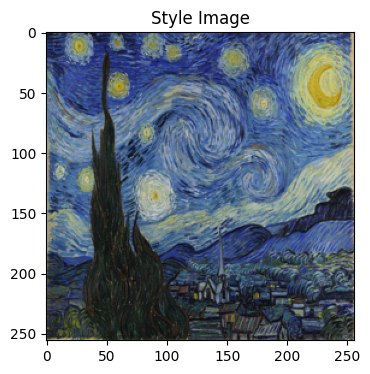

In [18]:
# imshow(style_image, "Style Image")
ImageShow(styleImage, "Style Image")


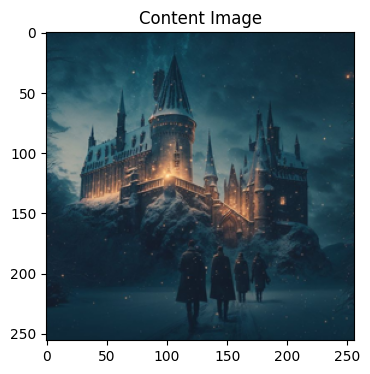

In [19]:
# imshow(content_image, "Content Image")
ImageShow(contentImage, "Content Image")

### 2.2 - VGG19 Model (15/90 pts)

One of the important parts of Neural Style Transfer is to use a pre-trained model to extract features from the content and style images. Here, we are going to use a pre-trained VGG19 model to extract features from the images. You can use `torchvision.models.vgg19` to load the model. You should also freeze the weights of the model to prevent them from updating during the optimization process.

<div style="text-align:center;">
  <img src="./Images/VGG-19.png" />
</div>

But what is VGG model? Let's see with a simple experiment:

In [20]:
import certifi
import os

os.environ['SSL_CERT_FILE'] = certifi.where()

Here, please load `VGG19` model from `torchvision.models` and see the architecture of the model. You may need models `features` and `classifier` part stored seperately as we will discuss these both parts.

In [21]:
#TODO
from torchvision.models import vgg19

# Load the pre-trained VGG19 model
vgg_model = vgg19(weights=VGG19_Weights.IMAGENET1K_V1)

# Extract the features and classifier parts of the VGG19 model
vgg_model_features = vgg_model.features
vgg_model_classifier = vgg_model.classifier

In [22]:
import torchsummary

#TODO: Print the summary of the vgg_model
# Print the summary of the VGG19 model
torchsummary.summary(vgg_model, input_size=(3, 224, 224))

# Optionally, you can print the summary of the features and classifier parts separately
print("\nVGG19 Features Summary:")
torchsummary.summary(vgg_model_features, input_size=(3, 224, 224))

print("\nVGG19 Classifier Summary:")
torchsummary.summary(vgg_model_classifier, input_size=(7 * 7 * 512,))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           1,792
              ReLU-2         [-1, 64, 224, 224]               0
            Conv2d-3         [-1, 64, 224, 224]          36,928
              ReLU-4         [-1, 64, 224, 224]               0
         MaxPool2d-5         [-1, 64, 112, 112]               0
            Conv2d-6        [-1, 128, 112, 112]          73,856
              ReLU-7        [-1, 128, 112, 112]               0
            Conv2d-8        [-1, 128, 112, 112]         147,584
              ReLU-9        [-1, 128, 112, 112]               0
        MaxPool2d-10          [-1, 128, 56, 56]               0
           Conv2d-11          [-1, 256, 56, 56]         295,168
             ReLU-12          [-1, 256, 56, 56]               0
           Conv2d-13          [-1, 256, 56, 56]         590,080
             ReLU-14          [-1, 256,

Please briefly explain what is a VGG model used for and what does each `features` and `classifier` part, represent?

**Your Answer:**

It is a convolutional neural network widely used for image classification and feature extraction.

I have personally used its VGG16 variation for my final thesis of computer engineering project in Bachelor Science, where I did implement a system to recognize and track faces and sequence of faces in video scenes.
 
It consists of two main parts: the features part, which includes a series of convolutional and max-pooling layers to extract high-level features from images, and the classifier part, which consists of fully connected layers that use these features to perform the final classification. 

The model is known for its simplicity and effectiveness, particularly in achieving top results in image recognition tasks, and is commonly used in transfer learning due to its robust feature extraction capabilities.

Now, we are going to give a sample image `Images/Neural_Transfer/Car.jpeg` to the model, see the output for classification and also visualize the feature maps (outputs of each convolutional layer) to see what's going on!

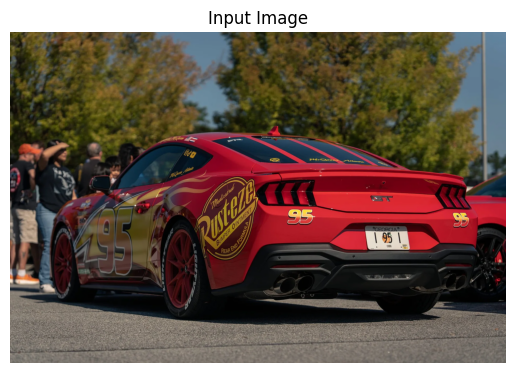

Predicted class: 817


In [24]:
# Load the sample image
vgg_test_image = Image.open("./Images/Neural_Transfer/Car.jpeg")

#TODO: Plot the image which we are feeding to the model

# Plot the image which we are feeding to the model
plt.imshow(vgg_test_image)
plt.title("Input Image")
plt.axis('off')
plt.show()


#TODO: required transformations for the input to the vgg model
# Required transformations for the input to the VGG model
preprocess_vgg = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize the image to 224x224 as expected by VGG19
    transforms.ToTensor(),  # Convert the image to a PyTorch tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406],  # Normalize with ImageNet mean
                         std=[0.229, 0.224, 0.225])   # Normalize with ImageNet std
])

# Preprocess the image
input_tensor = preprocess_vgg(vgg_test_image)
input_batch = input_tensor.unsqueeze(0)  # Add batch dimension

# Ensure the model is in evaluation mode
vgg_model.eval()

# Move the input to the appropriate device
input_batch = input_batch.to(device)
vgg_model = vgg_model.to(device)

#TODO: Predict the output of the vgg model for the test image (final classifier output and also each feature map output (in Conv2D layers))
# Predict the output of the VGG model for the test image
with torch.no_grad():
    output = vgg_model(input_batch)

# Get the predicted class
_, predicted_class = torch.max(output, 1)
predicted_class = predicted_class.item()

# Print the predicted class
print(f"Predicted class: {predicted_class}")

# Function to visualize the feature maps
def visualize_feature_maps(model, input_image):
    layers = [layer for layer in model.features if isinstance(layer, nn.Conv2d)]
    x = input_image
    for i, layer in enumerate(layers):
        x = layer(x)
        feature_map = x[0].detach().cpu().numpy()
        fig, axarr = plt.subplots(1, min(8, feature_map.shape[0]))
        fig.suptitle(f"Feature maps after Conv layer {i + 1}", fontsize=16)
        for idx in range(min(8, feature_map.shape[0])):
            axarr[idx].imshow(feature_map[idx], cmap='gray')
            axarr[idx].axis('off')
        plt.show()

# Visualize the feature maps for each Conv2D layer
# Disabled visualization for smaller notebook size
# visualize_feature_maps(vgg_model, input_batch)

As you can see, the output of the classifier is an integer. This integer is actually the **class number** in _Image Net_ dataset. Let's get the name of the class:

In [25]:
import requests

class_idx = requests.get(
    "https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json"
).json()

# Get the class name
class_name = class_idx[predicted_class]

print(f"Predicted class: {class_name}")

Predicted class: sports car


Now that we understood the architecture of VGG, and also the output of its classifier, it's time to extract features from the images! And see what's going on in the feature maps!

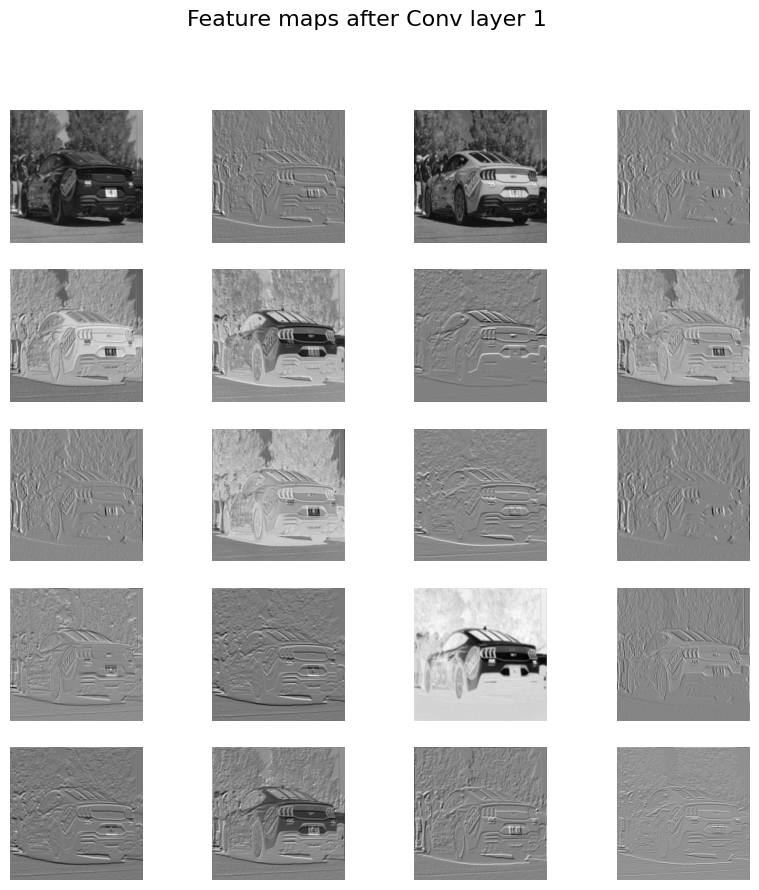

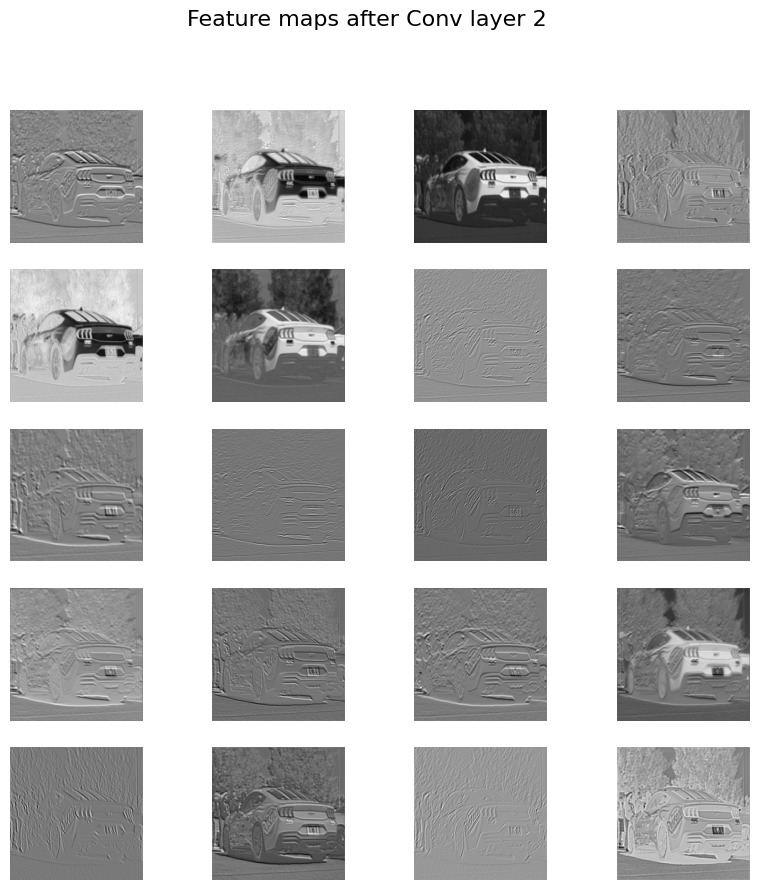

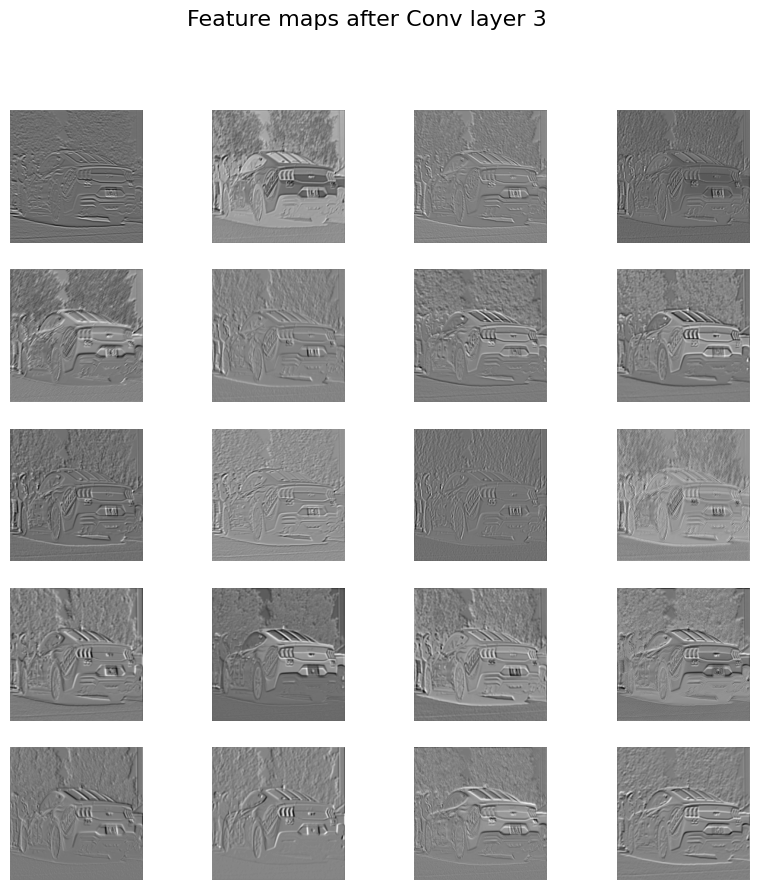

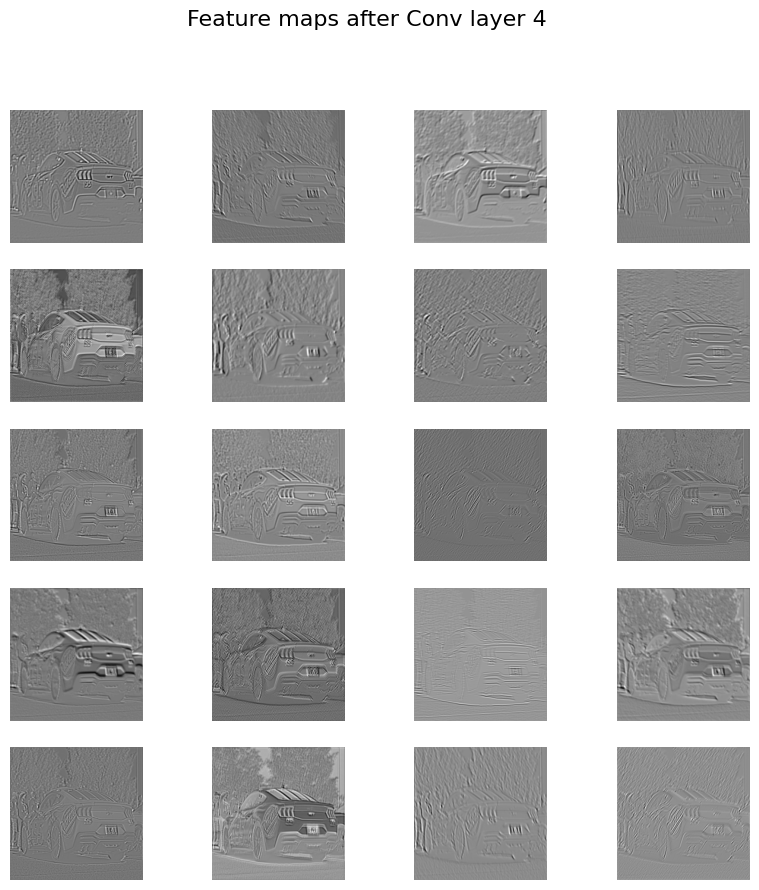

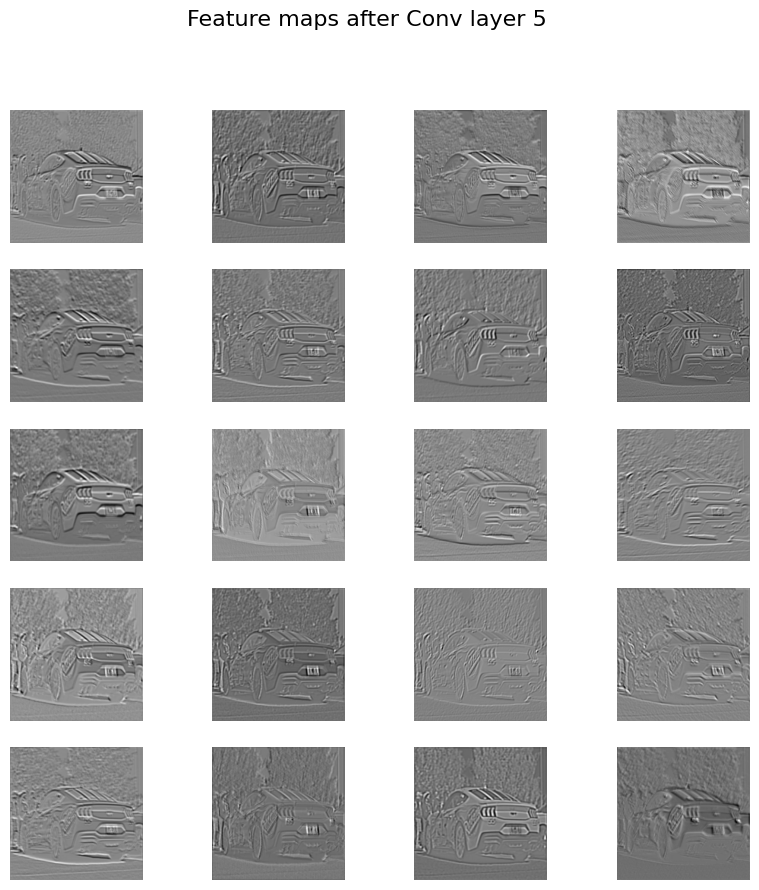

...

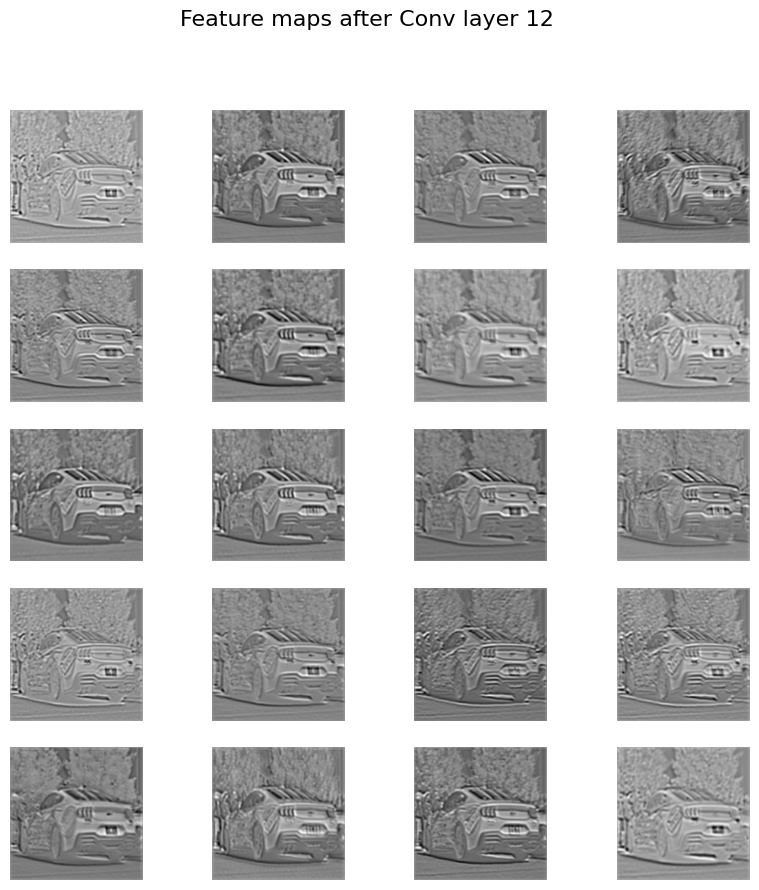

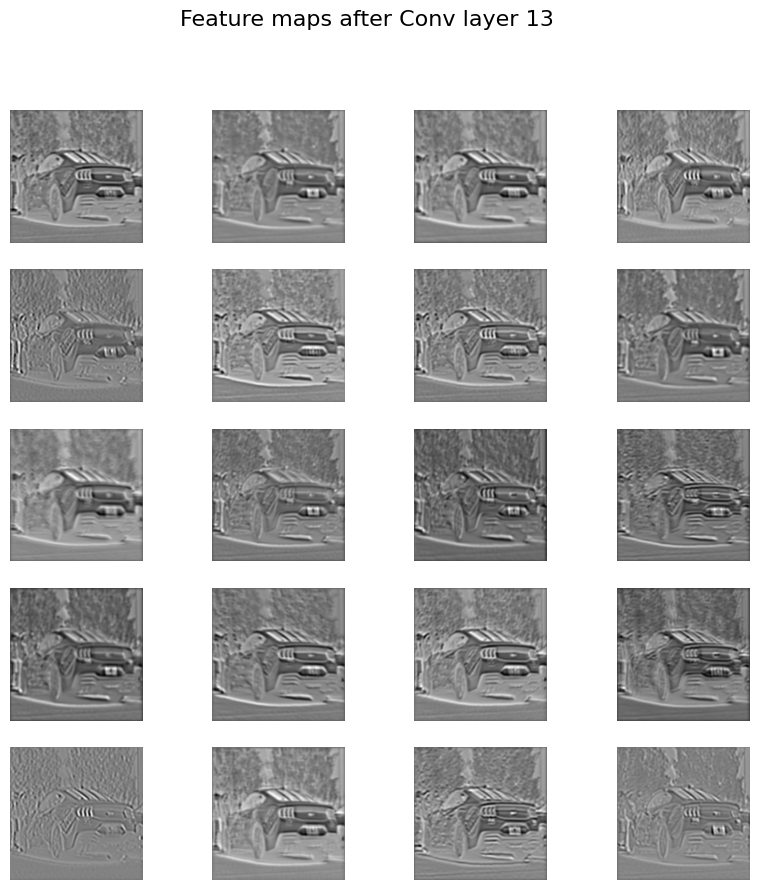

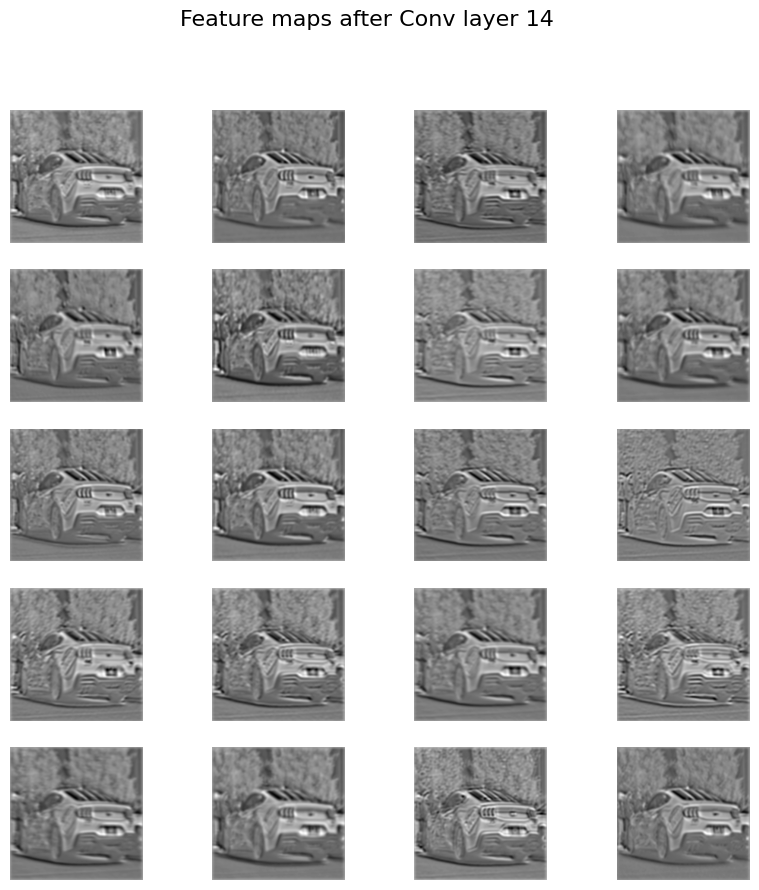

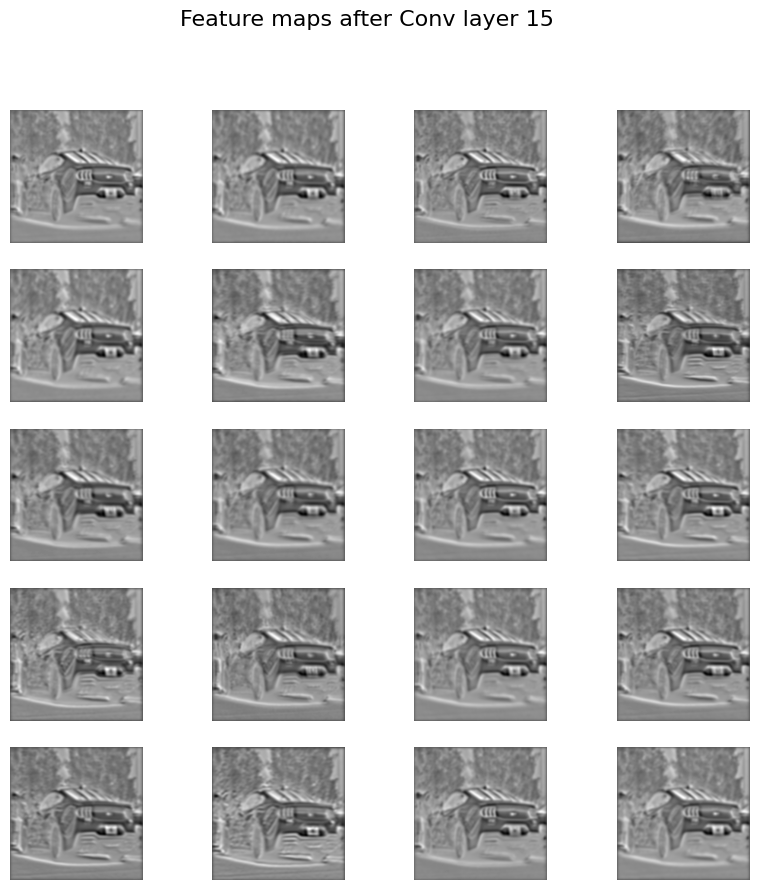

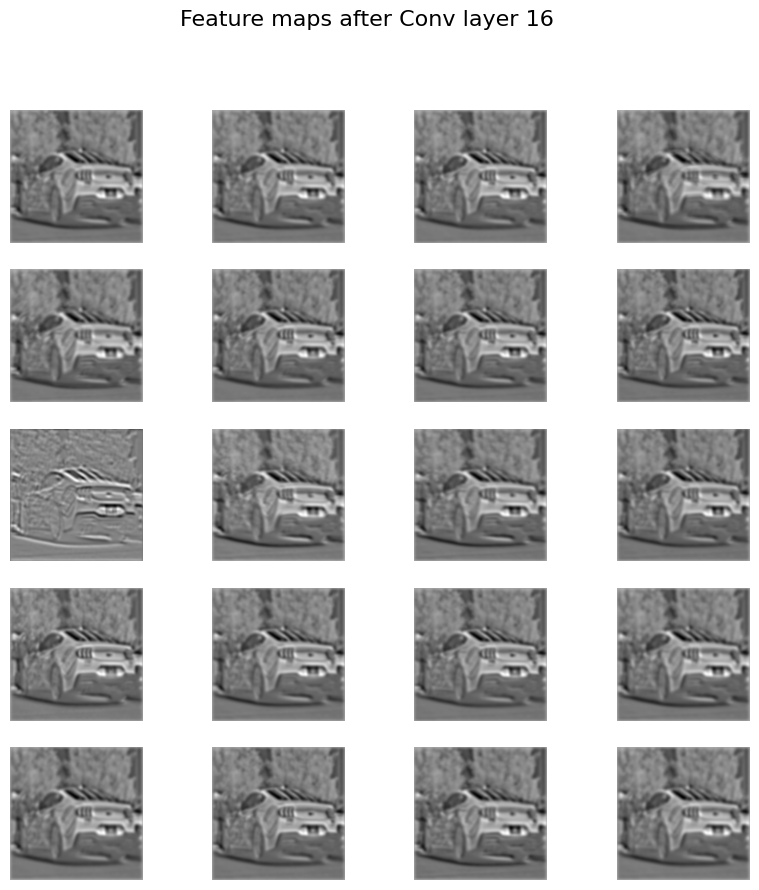

In [26]:
# Visualize the first 16 feature maps of each Conv2D layer (there are 16 Conv2D layers in VGG19)
#TODO
# I actually did that above, so I just repeat my code, just this time plot LARGER and for the first 20 features
# Function to visualize the feature maps
def visualize_feature_maps(model, input_image):
    layers = [layer for layer in model.features if isinstance(layer, nn.Conv2d)]
    x = input_image
    for i, layer in enumerate(layers):
        x = layer(x)
        feature_map = x[0].detach().cpu().numpy()  # Detach and convert to numpy array
        fig, axarr = plt.subplots(5, 4, figsize=(10, 10))
        fig.suptitle(f"Feature maps after Conv layer {i + 1}", fontsize=16)
        for idx in range(min(20, feature_map.shape[0])):
            ax = axarr[idx // 4, idx % 4]
            ax.imshow(feature_map[idx], cmap='gray')
            ax.axis('off')
        plt.show()

# Visualize the feature maps for each Conv2D layer
visualize_feature_maps(vgg_model, input_batch)

It's fun too look under the hood, isn't it? As you can see, we can guess what are the learned features in each layer if the network (at least in the first layers). For example, in the first layer, the network learns to detect edges, and in the second layer, it learns to detect simple shapes. In the deeper layers, the network learns to detect more complex features.

### 2.3 - Content and Style Loss (15/90 pts)

In order to learn the correct image and keep the content of the original image while applying the style of the seconf image, we need 2 losses: 1. Content Loss and 2. Style Loss. Let's delve into each one!

**Content Loss** is responsible for keeping the content of the original image. It is calculated as the mean squared error between the feature maps of the original image and the generated image.

In [27]:
class ContentLoss(nn.Module):
    def __init__(self, target):
        super(ContentLoss, self).__init__()
        # The target is the feature map of the original image
        # We detach the target to ensure it is not part of the computational graph
        self.target = target.detach()
        # Initialize the loss variable to 0
        self.loss = 0.0

    def forward(self, input):
        # Calculate the mean squared error between the input and the target
        self.loss = F.mse_loss(input, self.target)
        # Return the input to allow this layer to be inserted in a sequential model
        return input

**Style Loss** is responsible for applying the style of the second image to the generated image. It is calculated as the mean squared error between the Gram matrices of the feature maps of the second image and the generated image.

In [28]:
def gram_calculator(input):
    """
    Calculate the normalized Gram Matrix of a given input
    """
    # Get the batch size, number of feature maps, height, and width of the input tensor
    b, c, h, w = input.size()
    
    # Reshape the input tensor to a 2D matrix of shape (c, h * w)
    features = input.view(b * c, h * w)
    
    # Calculate the Gram matrix
    gram_matrix = torch.mm(features, features.t())
    
    # Normalize the Gram matrix by dividing by the number of elements in each feature map
    gram_matrix = gram_matrix.div(b * c * h * w)
    
    return gram_matrix

In [29]:
class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        # Calculate and detach the Gram matrix of the target feature
        self.target = gram_calculator(target_feature).detach()
        # Initialize the loss variable to 0
        self.loss = 0.0

    def forward(self, input):
        # Calculate the Gram matrix of the input feature map
        G = gram_calculator(input)
        # Calculate the mean squared error between the Gram matrices
        self.loss = F.mse_loss(G, self.target)
        # Return the input to allow this layer to be inserted in a sequential model
        return input

Now, we use `features` part of the VGG model to extract features from the content and style images. Then, we calculate the content and style loss using the extracted features.

In [30]:
# Get the `features` part of the VGG19 model
cnn = vgg19(weights=VGG19_Weights.IMAGENET1K_V1).features #TODO: Get the `features` part of the VGG19 model

In [31]:
cnn_normalization_mean = torch.tensor(
    [0.485, 0.456, 0.406]
)  # Normalization mean for the VGG19 model
cnn_normalization_std = torch.tensor(
    [0.229, 0.224, 0.225]
)  # Normalization std for the VGG19 model


# Normalize the images in order to feed it to the VGG19 model
class Normalization(nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()
        # print(mean.view(3, 1, 1))
        # Reshape mean and std to [C, 1, 1] so they can be directly used for broadcasting
        self.mean = mean.view(3, 1, 1)
        self.std = std.view(3, 1, 1)

    def forward(self, img):
        # Normalize the image
        return (img - self.mean) / self.std

# Create a normalization layer
normalization = Normalization(cnn_normalization_mean, cnn_normalization_std).to(device)


Please note that after which layers you should calculate the content loss and after which ones, you should calculate the style loss. Use the layer names you saw earlier in the `torchsummary` output for VGG19 model.

In [32]:
# Define the default content and style layers based on VGG19 architecture
content_layers_default = ['conv_4']  # Content loss is typically calculated after the fourth convolutional layer
# content_layers_default = ['conv_11']  # Content loss is typically calculated after the fourth convolutional layer
# style_layers_default = ['conv_1', 'conv_3', 'conv_5', 'conv_9', 'conv_13']  # Style loss is calculated after specific convolutional layers
style_layers_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']  # Style loss is calculated after specific convolutional layers
# style_layers, content_layers = [0, 5, 10, 19, 28], [25]

# rgb_mean = torch.tensor([0.485, 0.456, 0.406])
# rgb_std = torch.tensor([0.229, 0.224, 0.225])


# def extract_features(content_layers, style_layers):
#     contents = []
#     styles = []
#     for i in range(len(cnn)):
#         X = cnn[i]
#         if i in style_layers:
#             styles.append(X)
#         if i in content_layers:
#             contents.append(X)
#     return contents, styles
# 
# def get_contents(image_shape, device):
#     # content_X = preprocesss(content_image, image_shape).to(device)
#     contents_Y, _ = extract_features(content_layers, style_layers)
#     return contents_Y
# 
# def get_styles(image_shape, device):
#     # style_X = preprocesss(style_image, image_shape).to(device)
#     _, styles_Y = extract_features(content_layers, style_layers)
#     return styles_Y
# 
# contents_Y = get_contents((512, 512), device)
# styles_Y = get_styles((512, 512), device)
# 
# for i in contents_Y:
#     print(i)
#     
# for i in styles_Y:
#     print(i.__class__.__name__)

# Function to get the model with content and style loss layers
def get_style_model_and_losses(cnn, normalization, style_img, content_img, content_layers, style_layers):
    # Clone the CNN to avoid modifying the original model
    cnn = copy.deepcopy(cnn)

    # Initialize lists to hold the content and style loss layers
    content_losses = []
    style_losses = []

    # Sequential model to which we will add layers
    # sgTO CHECK: For shadow debug later?!
    # model = nn.Sequential(normalization)
    model = nn.Sequential()
    model.add_module('norm', normalization)

    i = 0  # Increment every time we see a conv layer
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = f"conv_{i}"
        elif isinstance(layer, nn.ReLU):
            name = f"relu_{i}"
            # The in-place version doesn't play very nicely with the ContentLoss
            # and StyleLoss we insert below. So we replace with out-of-place ones here.
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = f"pool_{i}"
        elif isinstance(layer, nn.BatchNorm2d):
            name = f"bn_{i}"
        else:
            raise RuntimeError(f"Unrecognized layer: {layer.__class__.__name__}")

        model.add_module(name, layer)
        # print(name)

        if name in content_layers:
            print(name, "is in content layers")
            # Add content loss
            target = model(content_img).detach()
            content_loss = ContentLoss(target)
            model.add_module(f"content_loss_{i}", content_loss)
            content_losses.append(content_loss)

        if name in style_layers:
            print(name, "is in style layers")
            # Add style loss
            target_feature = model(style_img).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module(f"style_loss_{i}", style_loss)
            style_losses.append(style_loss)

    # Now we trim off the layers after the last content and style losses
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
            break

    model = model[:i + 1]

    return model, content_losses, style_losses

# get_style_model_and_losses(cnn, normalization, style_image, content_image, content_layers_default, style_layers_default)

# Define the layers we will use for content and style losses
content_layers = content_layers_default
style_layers = style_layers_default

In [33]:
# Plot the input image to the model
# TODO
# Now let's get the style model and the losses
input_img = contentImage.clone()
model, content_losses, style_losses = get_style_model_and_losses(cnn, normalization, styleImage, contentImage, content_layers, style_layers)
model, content_losses, style_losses

conv_1 is in style layers
conv_2 is in style layers
conv_3 is in style layers
conv_4 is in content layers
conv_4 is in style layers
conv_5 is in style layers


(Sequential(
   (norm): Normalization()
   (conv_1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
   (style_loss_1): StyleLoss()
   (relu_1): ReLU()
   (conv_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
   (style_loss_2): StyleLoss()
   (relu_2): ReLU()
   (pool_2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
   (conv_3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
   (style_loss_3): StyleLoss()
   (relu_3): ReLU()
   (conv_4): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
   (content_loss_4): ContentLoss()
   (style_loss_4): StyleLoss()
   (relu_4): ReLU()
   (pool_4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
   (conv_5): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
   (style_loss_5): StyleLoss()
 ),
 [ContentLoss()],
 [StyleLoss(), StyleLoss(), StyleLoss(), StyleLoss(), StyleLoss()])

(15/90 pts) Now, we need to define our optimizer. We use `LBFGS` optimizer. Let's get familiar with this optimizer a little bit:

Let's use this optimizer to optimize a simple function $f(x) = x^2$. We want to find the minimum of this function using `LBFGS` optimizer. First, you should initialize a tensor $x$ with a random value. Then, you should define a closure function that calculates the value of the function and its gradient. Finally, you should use the `step` method of the optimizer to update the value of $x$.

And lastly, you should generate an animation using `matplotlib.animation` to show how the value of $x$ changes during optimization.

In [6]:
import matplotlib.animation as animation
from torch.optim import LBFGS
import IPython.display as display


# TODO: Define a simple quadratic function
# f(x) = x^2
def quadratic_function(x):
    return x ** 2



# Initialize a tensor with a single random value (e.g. 5.0/7.0/10.0/...)
x = torch.tensor([7.0], requires_grad=True)

# Initialize the LBFGS optimizer
optimizer = LBFGS([x], lr=1.0, max_iter=100)

# List to store the history of x values
x_history = []

# Closure function to calculate the value of the function and its gradient
def closure():
    optimizer.zero_grad()  # Clear the gradients
    loss = quadratic_function(x)  # Calculate the function value
    loss.backward()  # Calculate the gradients
    x_history.append(x.item())  # Store the current value of x
    return loss

# Optimization loop
for _ in range(15):
    optimizer.step(closure)  # Perform one step of optimization

# Generate points for the quadratic function curve
x_curve = torch.linspace(-11, 11, 1000)
y_curve = quadratic_function(x_curve).numpy()

# Generate intermediate points to smooth the path
x_smooth = []
y_smooth = []
for i in range(1, len(x_history)):
    x_start = x_history[i - 1]
    x_end = x_history[i]
    # Interpolate 20 points between each pair of x_history points
    for t in torch.linspace(0, 1, 20):
        x_intermediate = x_start * (1 - t) + x_end * t
        y_intermediate = quadratic_function(torch.tensor([x_intermediate])).item()
        x_smooth.append(x_intermediate)
        y_smooth.append(y_intermediate)

# Add the final point
x_smooth.append(x_history[-1])
y_smooth.append(quadratic_function(torch.tensor([x_history[-1]])).item())

# Generate animation to show how the value of x changes during optimization
fig, ax = plt.subplots()
line, = ax.plot([], [], 'ro', markersize=12)
path_line, = ax.plot([], [], 'b-', lw=2)  # Line to show the path
ax.plot(x_curve, y_curve, 'g--', lw=1)  # Plot the quadratic function curve
ax.set_xlim(-11, 11)
ax.set_ylim(-1, 110)
ax.set_xlabel('x')
ax.set_ylabel('f(x) = x^2')
ax.grid()

def init():
    line.set_data([], [])
    path_line.set_data([], [])
    return line, path_line

def update(frame):
    x_val = x_smooth[frame]
    y_val = y_smooth[frame]
    line.set_data([x_val], [y_val])  # Ensure x_val and y_val are passed as sequences
    path_line.set_data(x_smooth[:frame + 1], y_smooth[:frame + 1])
    return line, path_line

ani = animation.FuncAnimation(fig, update, frames=len(x_smooth), init_func=init, blit=True, interval=100)

# Display the animation
html_video = ani.to_jshtml()
display.display(display.HTML(html_video))
plt.close()  # Prevent duplicate static plot from displaying

(35/90 pts) Now, let's use this optimizer to optimize our `input_image` to minimize the content and style loss. You should define a closure function that calculates the content and style loss and their gradients. Then, you should use the `step` method of the optimizer to update the value of the `input_image`. Please also **note** that you should use a weighted sum of the content and style loss to optimize the input image. (weight of each loss is a hyperparameter)

In [44]:
# Train your model using LBFGS optimizer and 2 implemented losses (style loss and content loss)
# You should report the `style loss`, `content loss`, and `total loss` for each iteration. Note that `total loss`
# is the sum of `style loss` and `content loss` with some weights (alpha and beta) which you should tune them.
# Also, please plot the image each 50 iterations.
# An important note is that your optimizer might change the values of the image tensor in a way that the pixel values
# are no longer in the range of [0, 1] (in normalized format). So, you should clip the values of the image tensor
# to be in the range of [0, 1] after each iteration, to prevent any problems occuring to your image.
# TODO

class Trainer():
    def __init__(self, model, contentLayers, styleLayers, device='cpu'):
        self.model = model.to(device)
        self.contentLayers = contentLayers
        self.styleLayers = styleLayers
        
    def fit(self, image, num_steps=300, alpha=1, betta=1e6, device='cpu'):
        image = image.to(device)
        optimizer = torch.optim.LBFGS([image.requires_grad_(True)])
        content_losses=[]
        style_losses=[]
        total_losses=[]
        run = [0]
        while run[0] <= num_steps:
            def closure():
                image.clamp(0, 1)
                optimizer.zero_grad()
                self.model(image)

                content_loss=0.
                style_loss=0.

                for contentLayer in self.contentLayers:
                    content_loss += contentLayer.loss
                for styleLayer in self.styleLayers:
                    style_loss += styleLayer.loss

                loss = alpha*content_loss + betta*style_loss
                loss.backward()
                content_losses.append(alpha*content_loss.item())
                style_losses.append(betta*style_loss.item())
                total_losses.append(loss.item())
                # Report the losses
                if run[0] % 50 == 0:
                    print(f"Iteration {run[0]}:")
                    print(f'Style Loss : {betta*style_loss.item()} Content Loss: {alpha*content_loss.item()}')
                    ImageShow(torch.clamp(image, 0, 1), title='Iteration {}/{}'.format(run[0], num_steps))

                run[0] += 1
                return loss
            optimizer.step(closure)

        losses={'total': total_losses, 'content': content_losses, 'style': style_losses}
        return losses, torch.clamp(image, 0, 1)

Iteration 0:
Style Loss : 15161.717310547829 Content Loss: 0.0


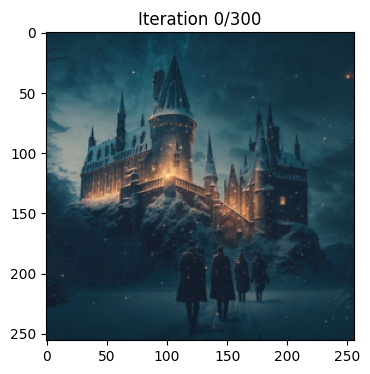

Iteration 50:
Style Loss : 97.1997287706472 Content Loss: 16.852306365966797


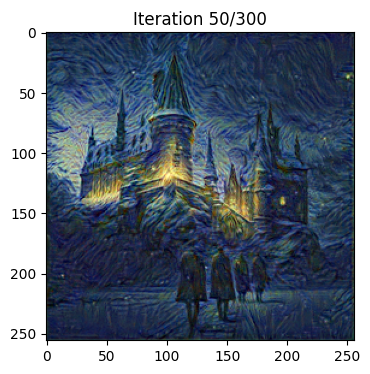

Iteration 100:
Style Loss : 18.87387224996928 Content Loss: 17.519224166870117


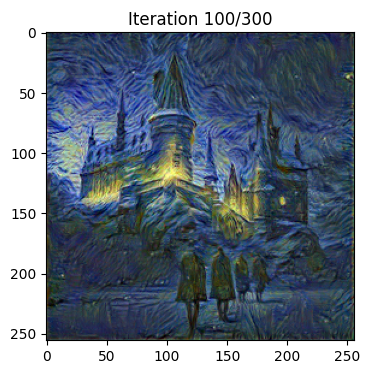

Iteration 150:
Style Loss : 5.48896878171945 Content Loss: 16.13119125366211


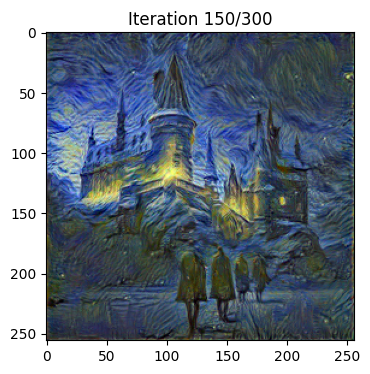

Iteration 200:
Style Loss : 3.5112643672619015 Content Loss: 14.309545516967773


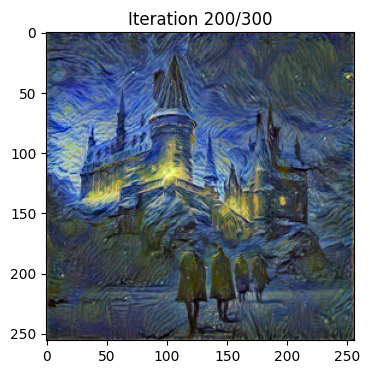

Iteration 250:
Style Loss : 2.7463561309559736 Content Loss: 13.260673522949219


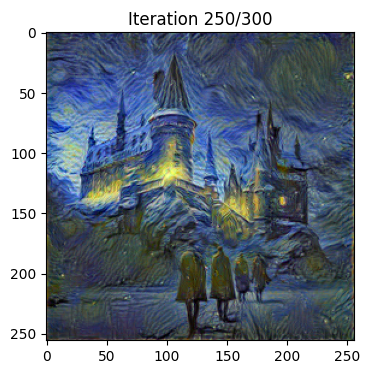

Iteration 300:
Style Loss : 2.262118869111873 Content Loss: 12.637354850769043


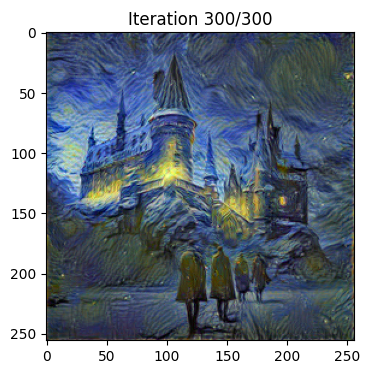

In [45]:
trainer = Trainer(model, content_losses, style_losses, device)

inputImage = contentImage.clone()
losses, outImage = trainer.fit(inputImage)

Now, let's see the result of optimization process on our `input_image`.

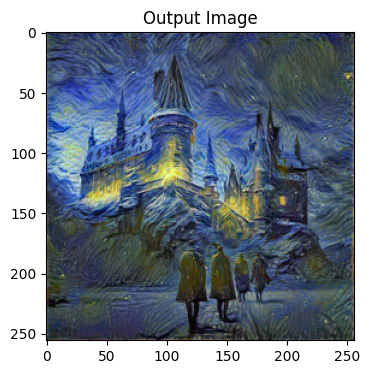

In [47]:
# TODO: Plot the final image
ImageShow(outImage, title='Output Image')


(5/90 pts) Also, let's plot our `style_losses`, `content_losses` and `total_losses` to see how they change during the optimization process.

In [48]:
tloss = losses['total']
closs = losses['content']
sloss = losses['style']


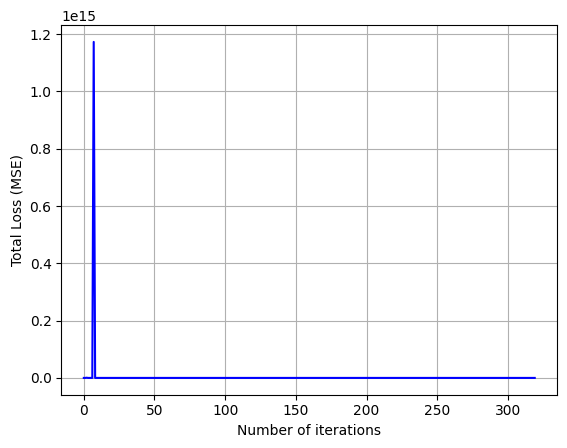

In [49]:
#TODO: Plot the total weighted loss w.r.t. the iteration number
plt.plot(tloss, 'b-')
plt.xlabel('Number of iterations')
plt.ylabel('Total Loss (MSE)')
plt.grid()

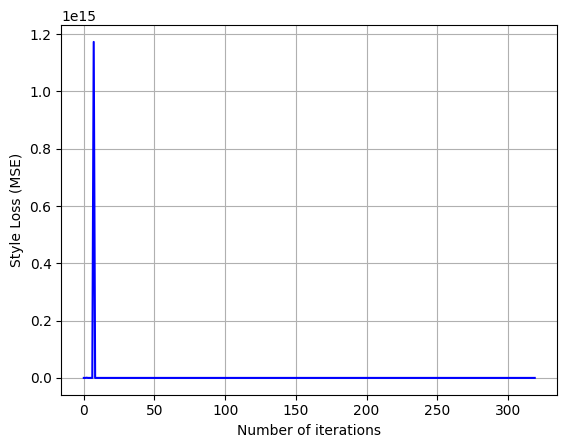

In [50]:
# TODO: Plot the style loss w.r.t. the iteration number
plt.plot(sloss, 'b-')
plt.xlabel('Number of iterations')
plt.ylabel('Style Loss (MSE)')
plt.grid()

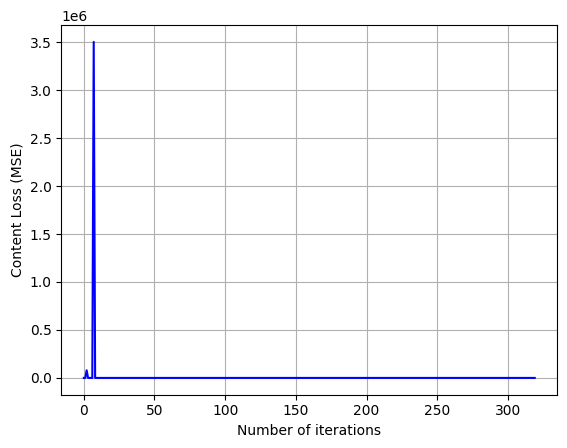

In [51]:
# TODO: Plot the content loss w.r.t. the iteration number
plt.plot(closs, 'b-')
plt.xlabel('Number of iterations')
plt.ylabel('Content Loss (MSE)')
plt.grid()